# Задание 1
# Ляшук Александр - 14 ПМИ
# Вариант 8
## Данные - MAGIC Gamma Telescope
https://archive.ics.uci.edu/ml/datasets/MAGIC+Gamma+Telescope
### Быстрый старт в анализ данных

**с помощью `Pandas` и `Scikit-learn`,**
**а также `numpy` и `matplotlib`**

- `numpy` – матричные операции
- `matplotlib` – научная графика
- `pandas` – таблицы (DataFrame) для анализа данных
- `scikit-learn` – алгоритмы машинного обучения



In [1]:
import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
from plotly.offline import init_notebook_mode, iplot
import plotly.graph_objs as go
from pylab import rcParams

from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import scale, normalize

import datetime
import warnings

warnings.simplefilter('ignore')
%matplotlib inline
rcParams['figure.figsize'] = (15.0, 8.0)
init_notebook_mode(connected=True)

### Выгрузим данные в Pandas DataFrame и посмотрим на них

In [2]:
data = pd.read_csv('../data/magic04.data',header=None)
data.columns = ['Length', 'Width','Size','Conc','Conc1','Asym','M3Long','M3Trans','Alpha','Dist','class']

In [3]:
data.head()

,Length,Width,Size,Conc,Conc1,Asym,M3Long,M3Trans,Alpha,Dist,class
0,28.7967,16.0021,2.6449,0.3918,0.1982,27.7004,22.0110,-8.2027,40.0920,81.8828,g
1,31.6036,11.7235,2.5185,0.5303,0.3773,26.2722,23.8238,-9.9574,6.3609,205.2610,g
2,162.0520,136.0310,4.0612,0.0374,0.0187,116.7410,-64.8580,-45.2160,76.9600,256.7880,g
3,23.8172,9.5728,2.3385,0.6147,0.3922,27.2107,-6.4633,-7.1513,10.4490,116.7370,g
4,75.1362,30.9205,3.1611,0.3168,0.1832,-5.5277,28.5525,21.8393,4.6480,356.4620,g


### Описание данных

`1.  Length:  continuous  # major axis of ellipse [mm] `  
`2.  Width:   continuous  # minor axis of ellipse [mm] `  
`3.  Size:    continuous  # 10-log of sum of content of all pixels [in #phot] `  
`4.  Conc:    continuous  # ratio of sum of two highest pixels over fSize  [ratio]`  
`5.  Conc1:   continuous  # ratio of highest pixel over fSize  [ratio] `  
`6.  Asym:    continuous  # distance from highest pixel to center, projected onto major axis [mm] `  
`7.  M3Long:  continuous  # 3rd root of third moment along major axis  [mm] `  
`8.  M3Trans: continuous  # 3rd root of third moment along minor axis  [mm] `   
`9.  Alpha:   continuous  # angle of major axis with vector to origin [deg] `  
`10. Dist:    continuous  # distance from origin to center of ellipse [mm] `  
`11. class:    g,h         # gamma (signal), hadron (background) `  

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 19020 entries, 0 to 19019
Data columns (total 11 columns):
Length     19020 non-null float64
Width      19020 non-null float64
Size       19020 non-null float64
Conc       19020 non-null float64
Conc1      19020 non-null float64
Asym       19020 non-null float64
M3Long     19020 non-null float64
M3Trans    19020 non-null float64
Alpha      19020 non-null float64
Dist       19020 non-null float64
class      19020 non-null object
dtypes: float64(10), object(1)
memory usage: 1.6+ MB


- Данные не содержат пропусков

In [5]:
data.describe()

,Length,Width,Size,Conc,Conc1,Asym,M3Long,M3Trans,Alpha,Dist
count,19020.000000,19020.000000,19020.000000,19020.000000,19020.000000,19020.000000,19020.000000,19020.000000,19020.000000,19020.000000
mean,53.250154,22.180966,2.825017,0.380327,0.214657,-4.331745,10.545545,0.249726,27.645707,193.818026
std,42.364855,18.346056,0.472599,0.182813,0.110511,59.206062,51.000118,20.827439,26.103621,74.731787
min,4.283500,0.000000,1.941300,0.013100,0.000300,-457.916100,-331.780000,-205.894700,0.000000,1.282600
25%,24.336000,11.863800,2.477100,0.235800,0.128475,-20.586550,-12.842775,-10.849375,5.547925,142.492250
50%,37.147700,17.139900,2.739600,0.354150,0.196500,4.013050,15.314100,0.666200,17.679500,191.851450
75%,70.122175,24.739475,3.101600,0.503700,0.285225,24.063700,35.837800,10.946425,45.883550,240.563825
max,334.177000,256.382000,5.323300,0.893000,0.675200,575.240700,238.321000,179.851000,90.000000,495.561000


In [6]:
data['class'].value_counts()

g    12332
h     6688
Name: class, dtype: int64

#### Итого:
- `12332` - класс g
- `6688` - класс h

**Cледовательно:** выборка несбалансированная

### Матрица корреляции признаков

In [7]:
data.corr()

,Length,Width,Size,Conc,Conc1,Asym,M3Long,M3Trans,Alpha,Dist
Length,1.000000,0.770512,0.702454,-0.630999,-0.598145,-0.368556,-0.119747,0.013389,-0.008777,0.418466
Width,0.770512,1.000000,0.717517,-0.609779,-0.581141,-0.266961,-0.176234,0.039744,0.066061,0.336816
Size,0.702454,0.717517,1.000000,-0.850850,-0.808835,-0.159863,0.095157,0.015455,-0.186675,0.437041
Conc,-0.630999,-0.609779,-0.850850,1.000000,0.976412,0.112272,-0.121899,-0.011294,0.235272,-0.328332
Conc1,-0.598145,-0.581141,-0.808835,0.976412,1.000000,0.100159,-0.118769,-0.010966,0.229799,-0.304625
Asym,-0.368556,-0.266961,-0.159863,0.112272,0.100159,1.000000,0.274045,0.002553,-0.055689,-0.206730
M3Long,-0.119747,-0.176234,0.095157,-0.121899,-0.118769,0.274045,1.000000,-0.017197,-0.186275,0.037025
M3Trans,0.013389,0.039744,0.015455,-0.011294,-0.010966,0.002553,-0.017197,1.000000,0.004659,0.011427
Alpha,-0.008777,0.066061,-0.186675,0.235272,0.229799,-0.055689,-0.186275,0.004659,1.000000,-0.220556
Dist,0.418466,0.336816,0.437041,-0.328332,-0.304625,-0.206730,0.037025,0.011427,-0.220556,1.000000


### Визуализация матрицы корреляции для наглядности

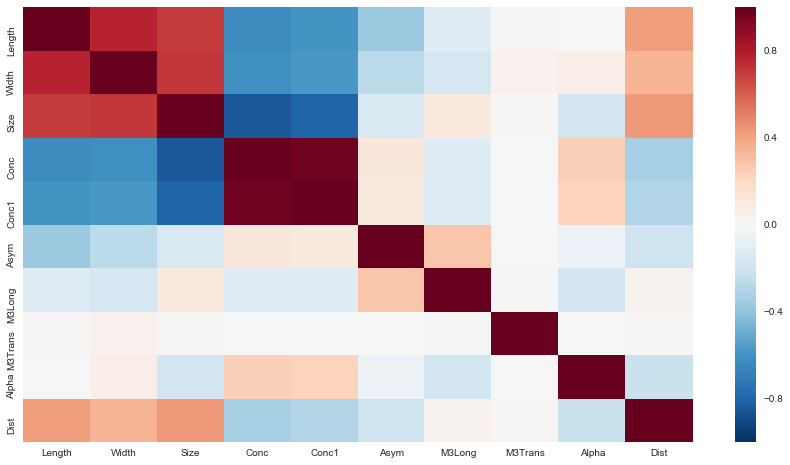

In [8]:
sns.heatmap(data.iloc[:,:-1].corr())

- Видно, что признаки **`Conc`** и **`Conc1`** коррелируют очень сильно - **0.97**
- Кроме того, **`Length`**, **`Width`** и **`Size`** так же сильно коррелируют

### Построим, как связаны между собой разные признаки
Для этого, посмотрим на диаграммы рассеяния и распределения признаков

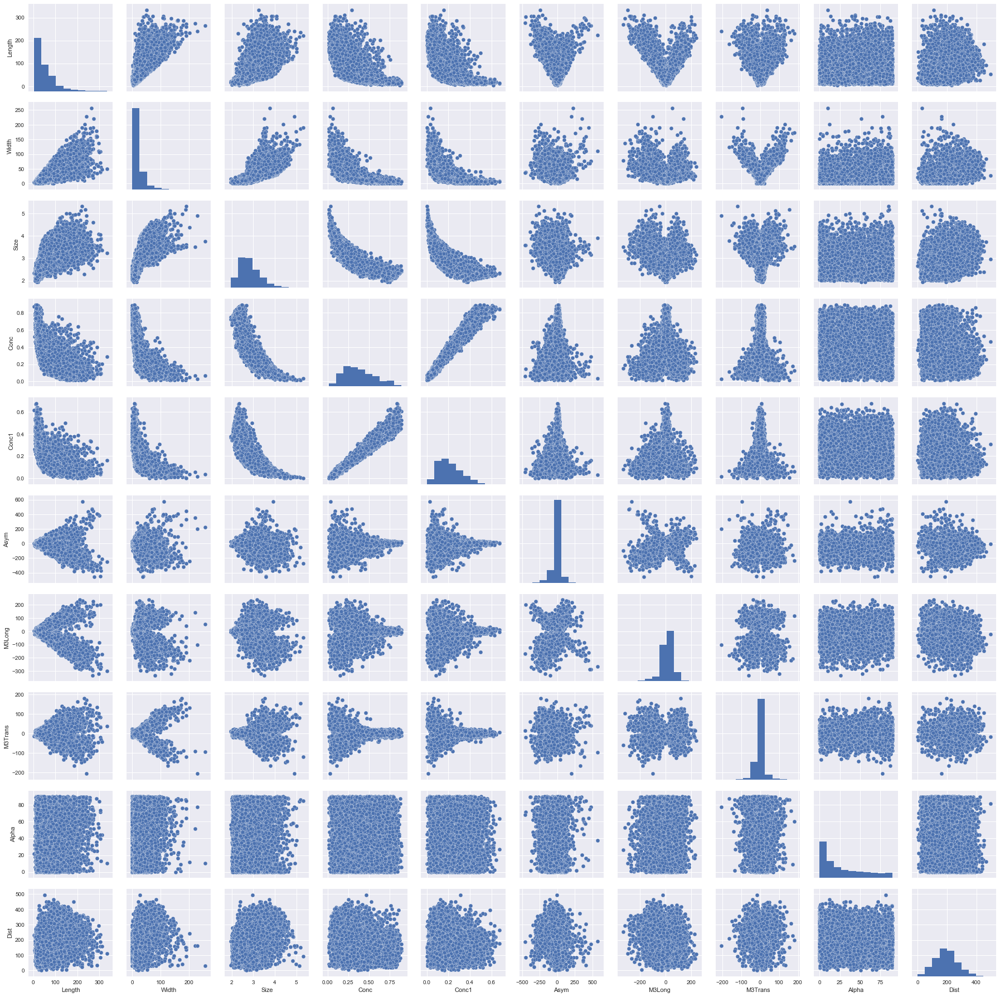

In [9]:
sns.pairplot(data.iloc[:,:-1])

### Например, диаграмма рассеяния для длины и ширины

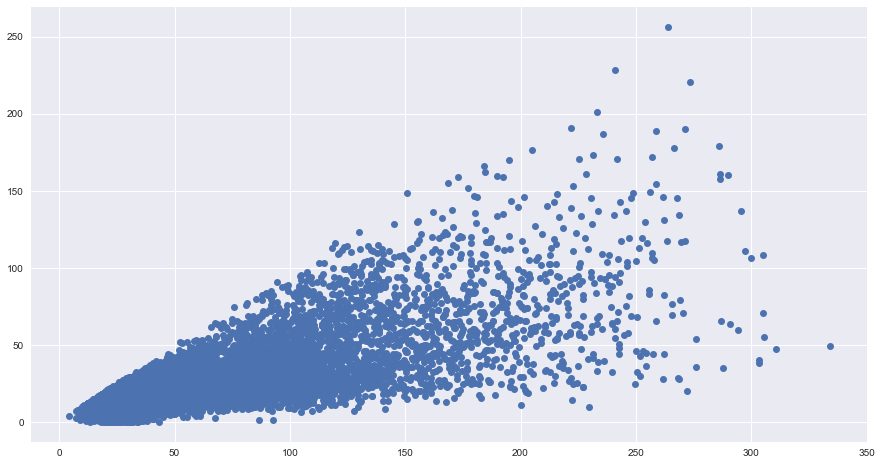

In [10]:
plt.plot(data['Length'], data['Width'], 'o', alpha = 1)

### Или, например, диаграмма рассеяния с соответствующими классами

Length Width


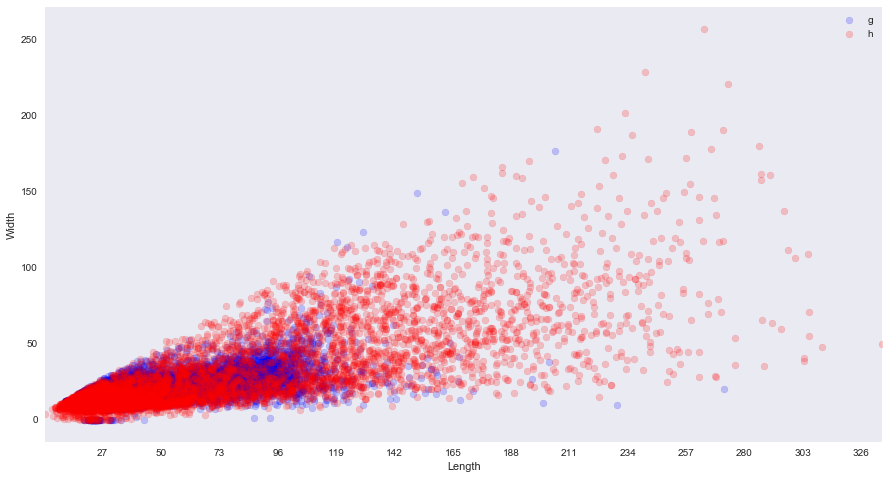

Length Size


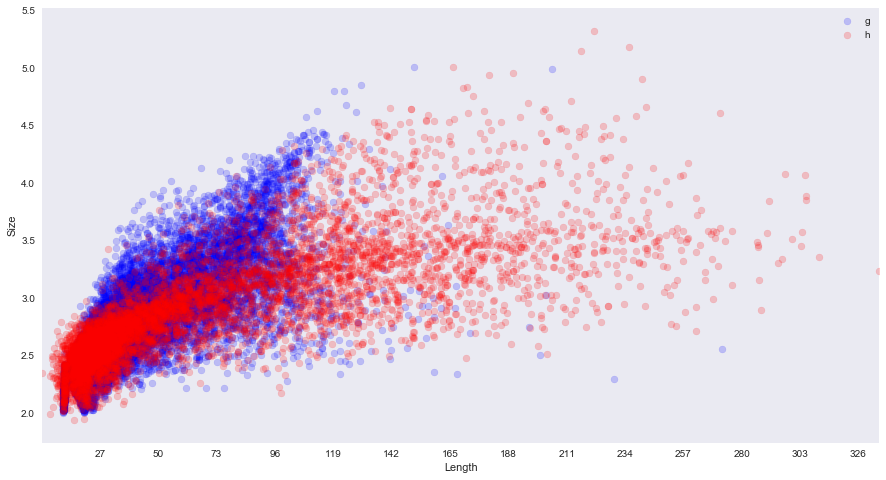

Length Conc


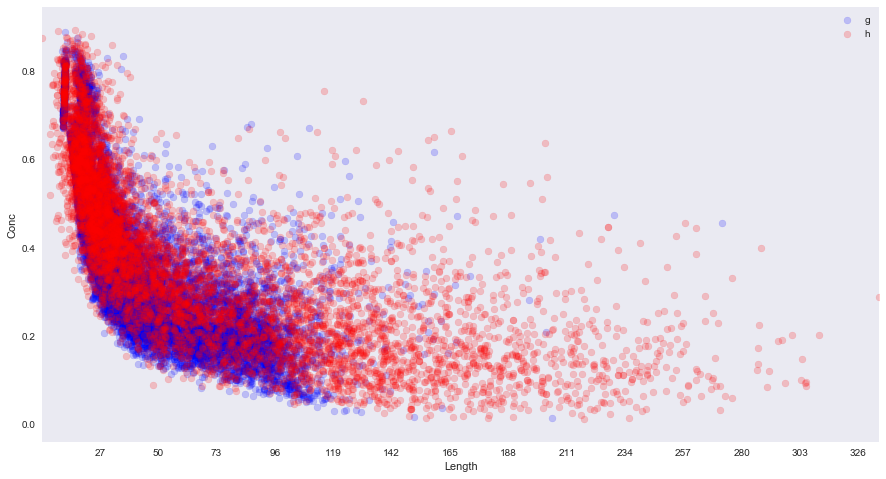

Length Conc1


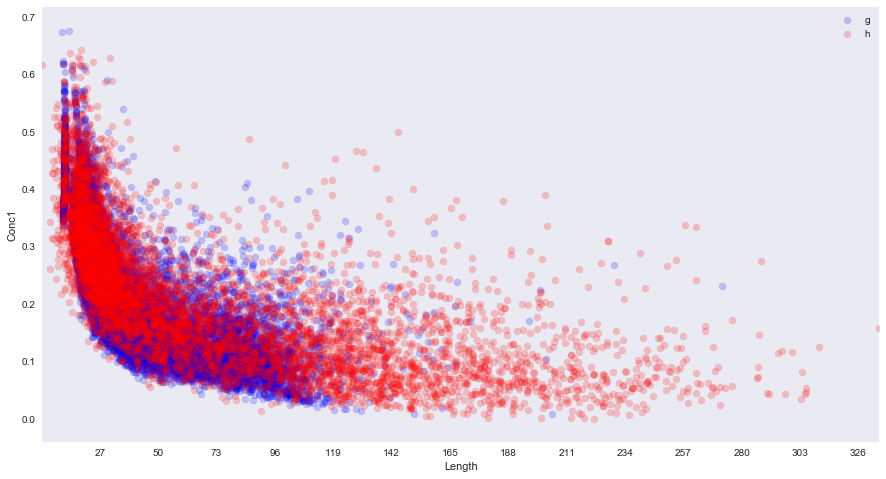

Length Asym


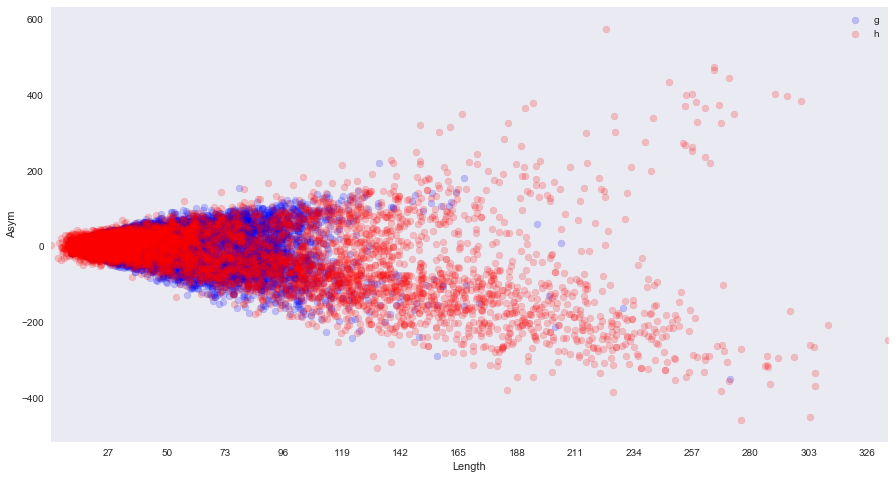

Length M3Long


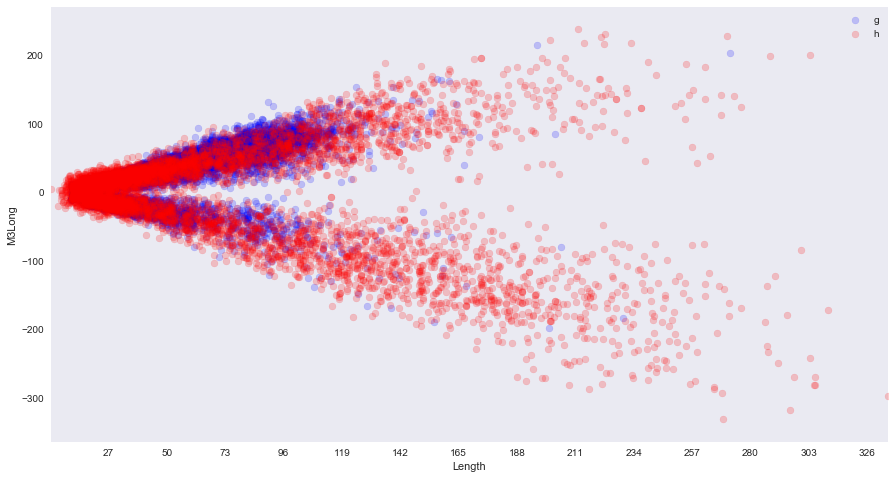

Length M3Trans


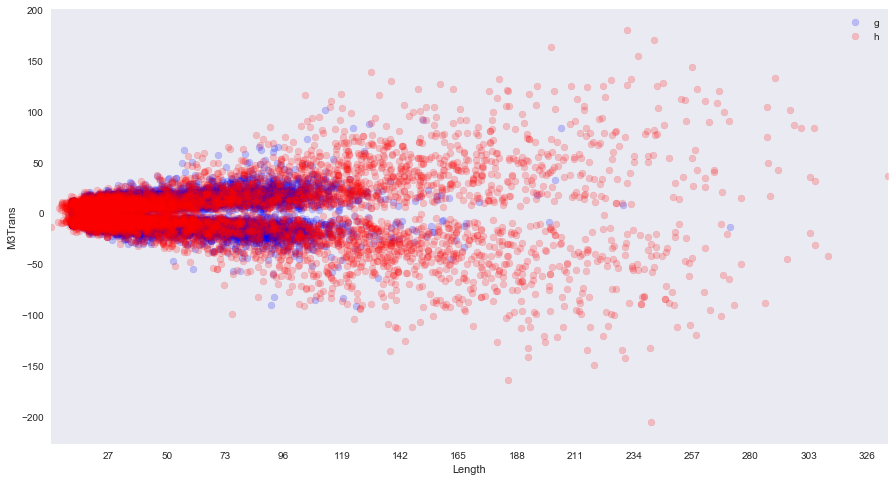

Length Alpha


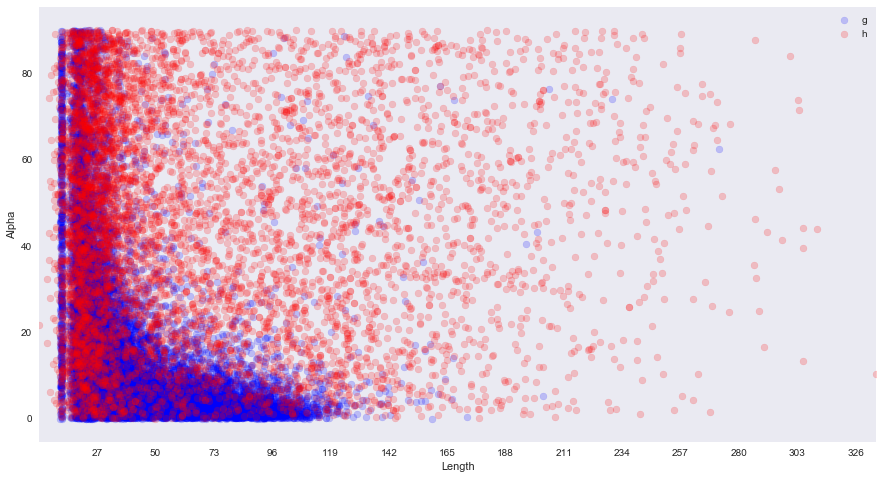

Length Dist


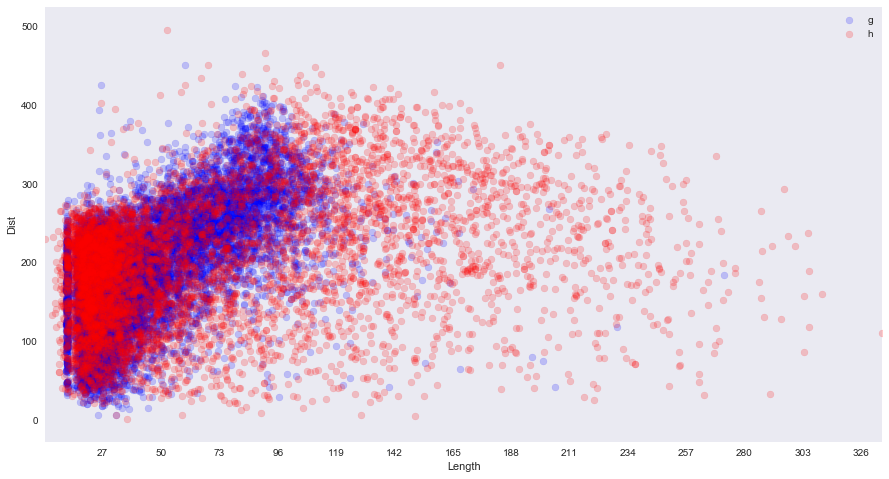

Width Size


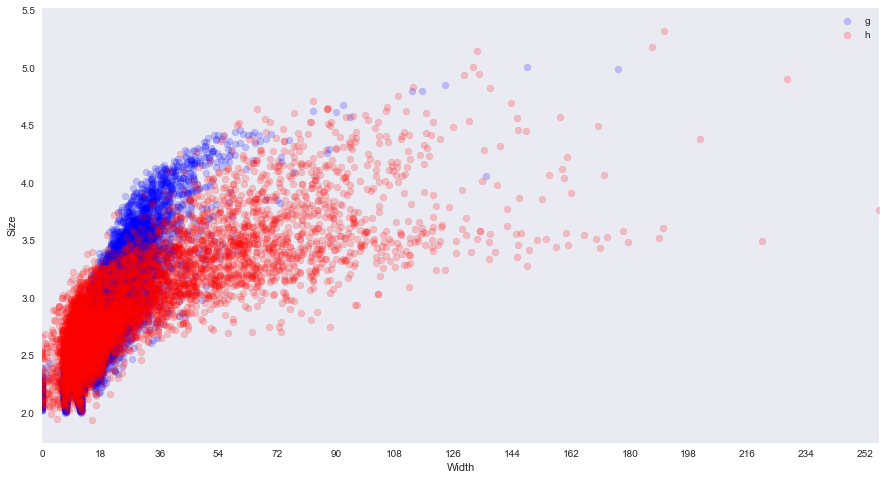

Width Conc


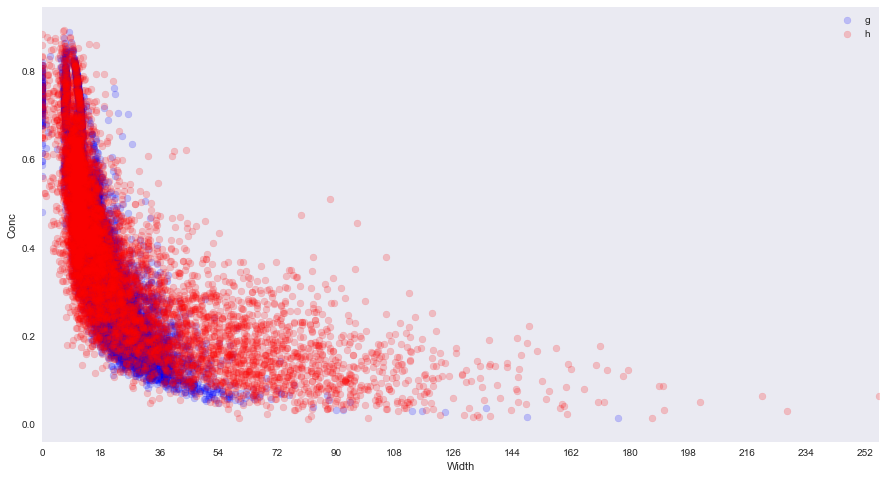

Width Conc1


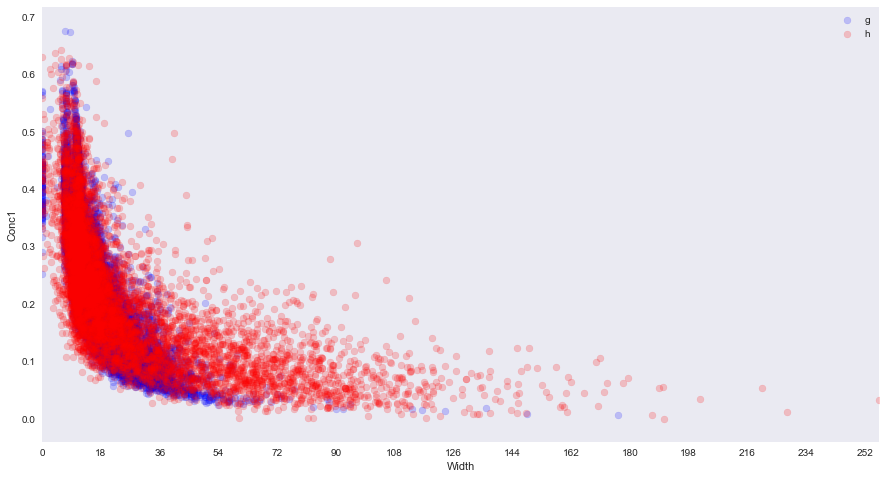

Width Asym


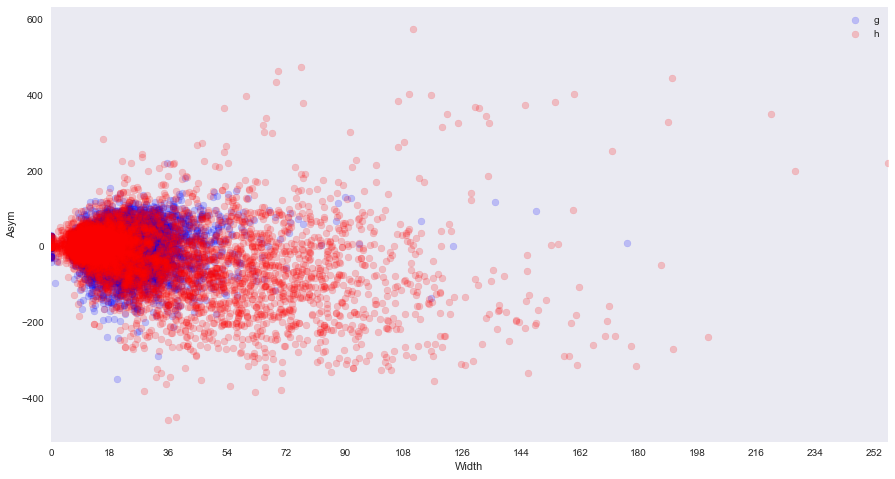

Width M3Long


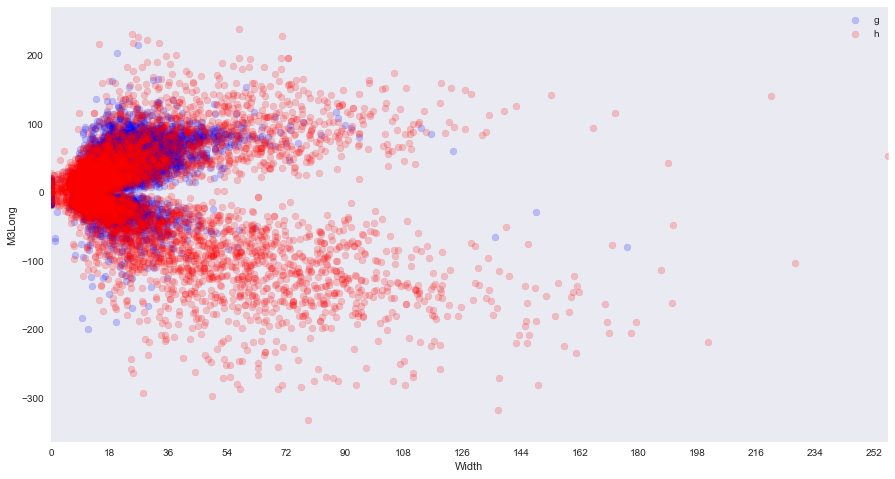

Width M3Trans


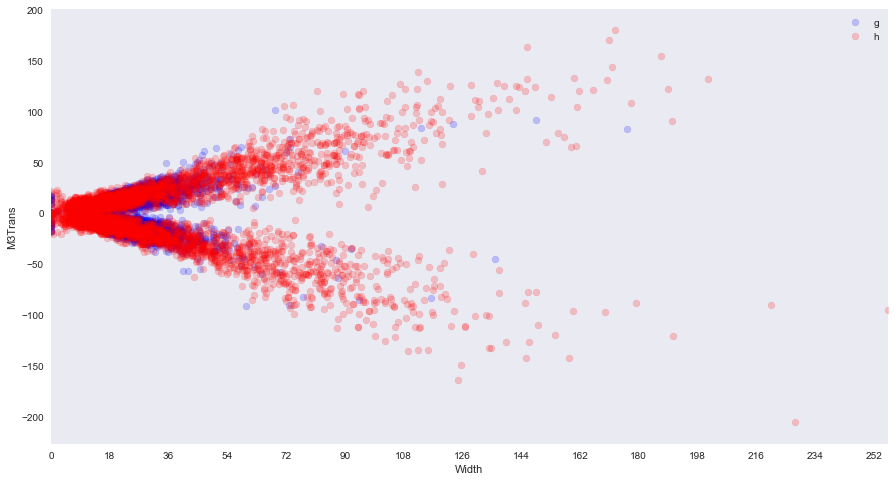

Width Alpha


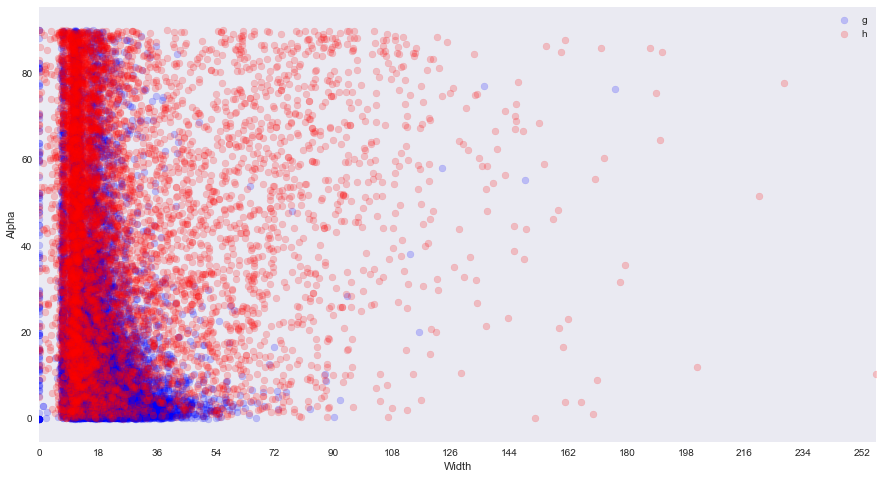

Width Dist


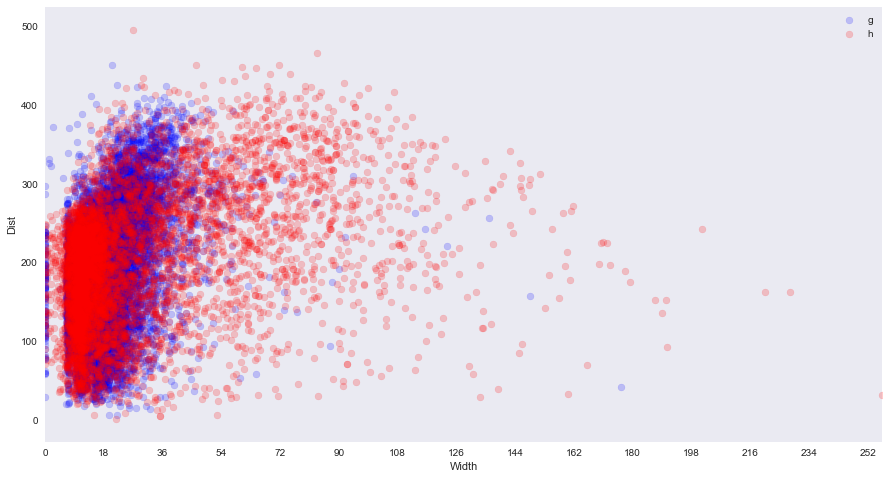

Size Conc


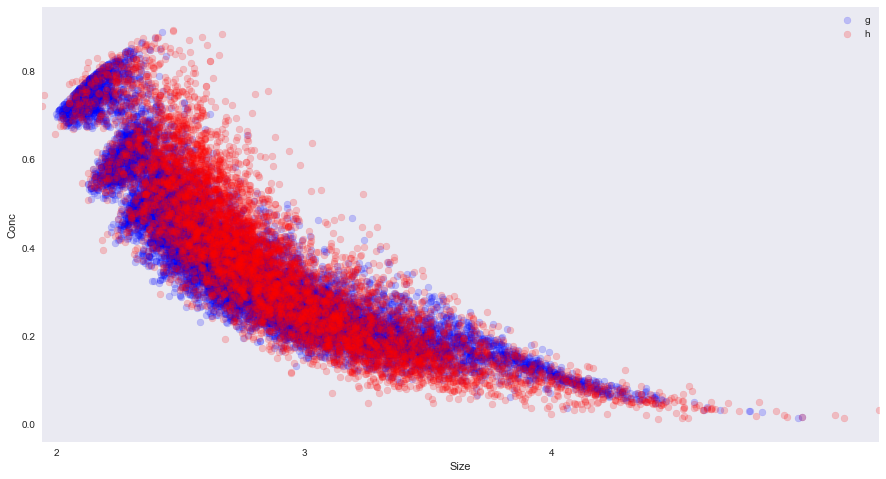

Size Conc1


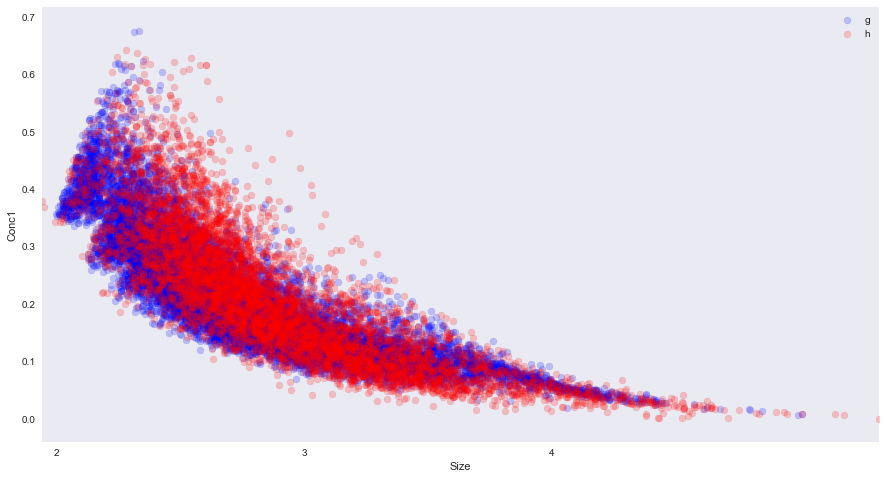

Size Asym


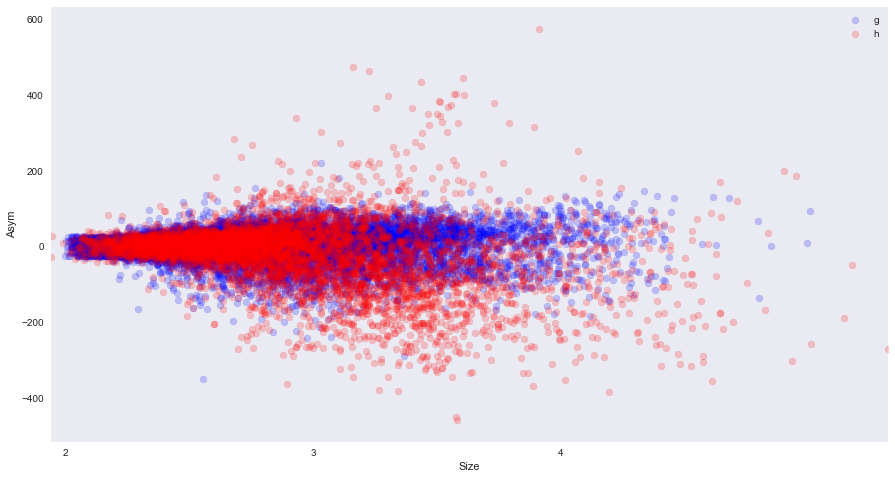

Size M3Long


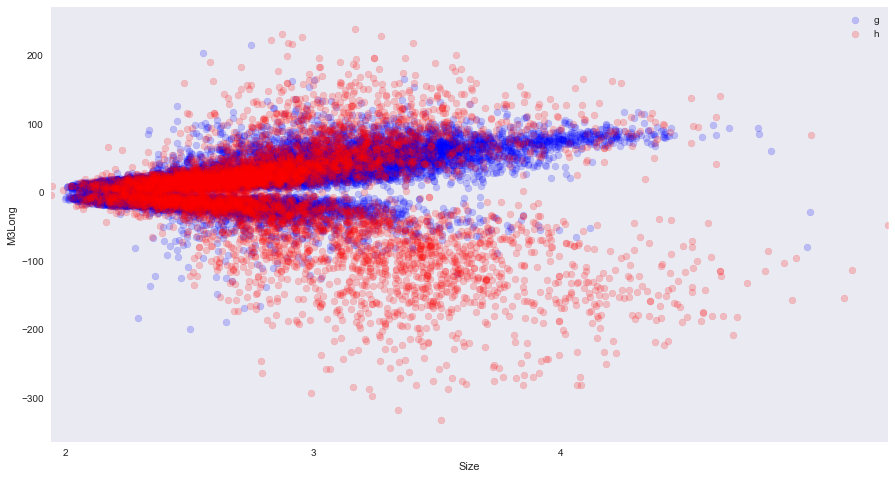

Size M3Trans


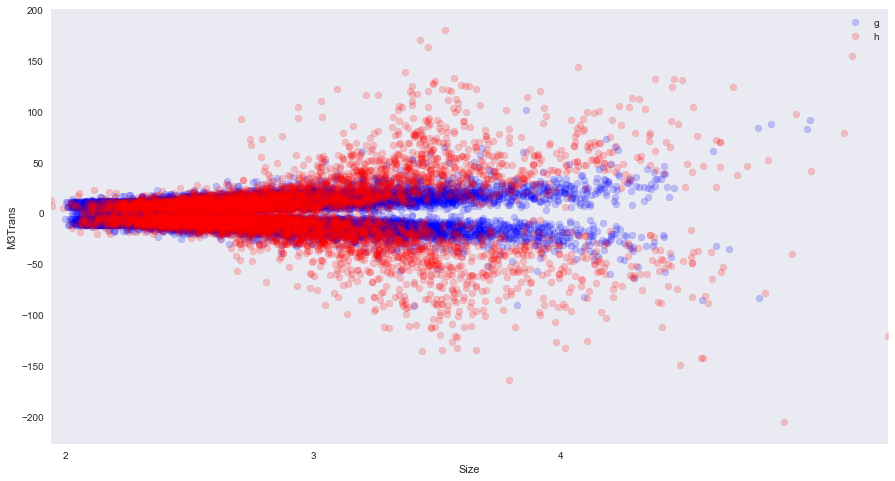

Size Alpha


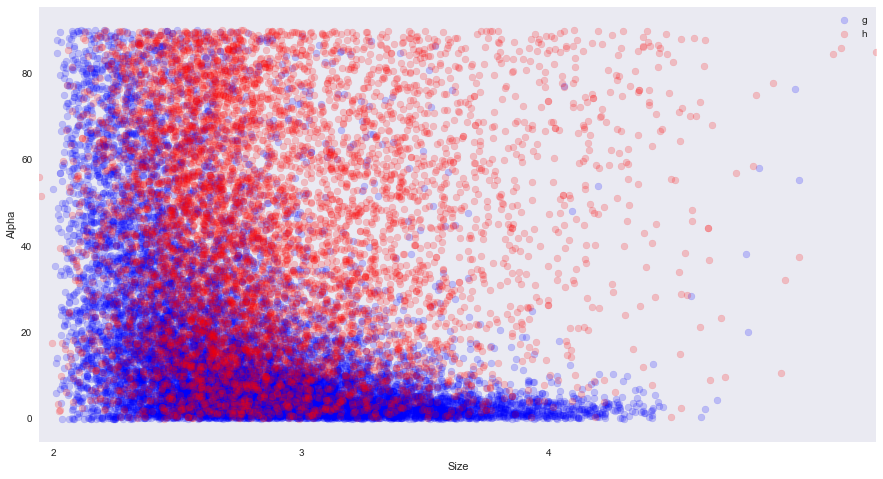

Size Dist


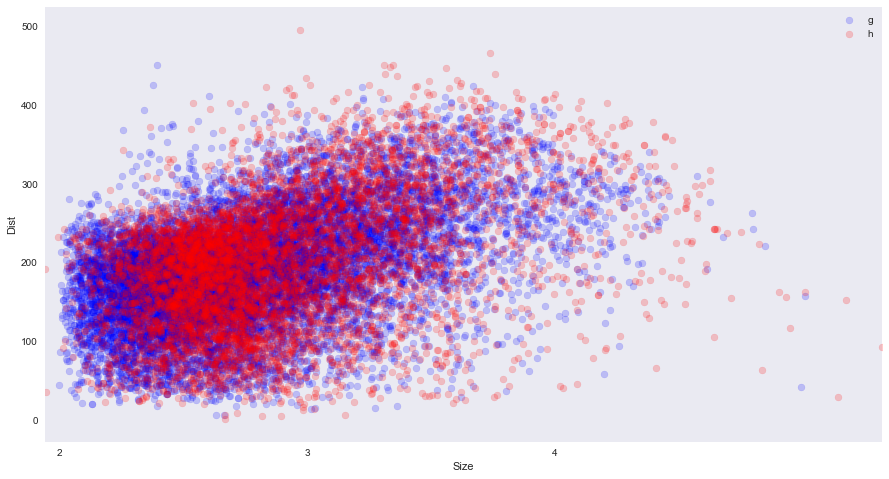

Conc Conc1


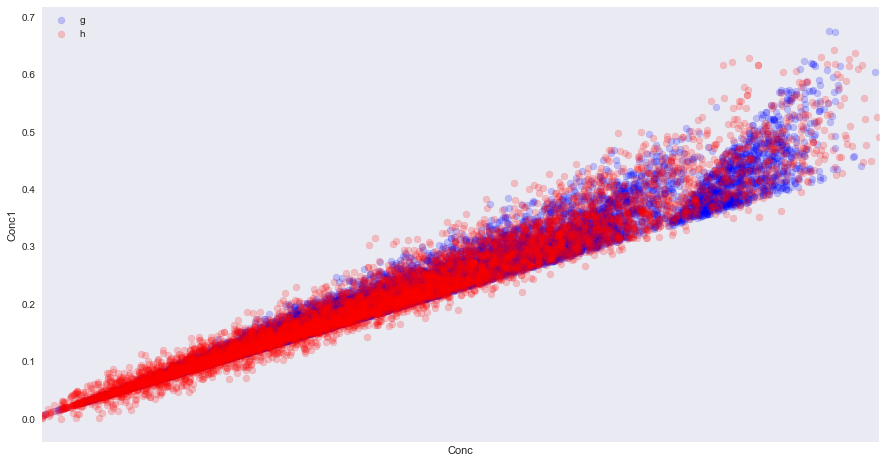

Conc Asym


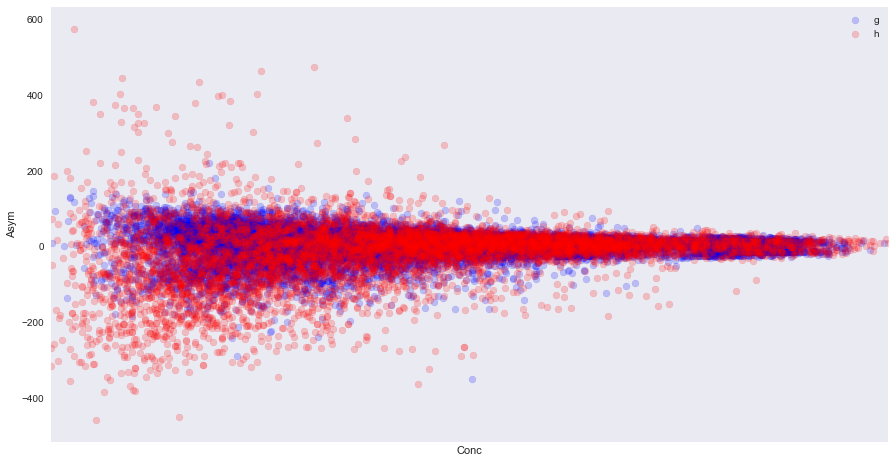

Conc M3Long


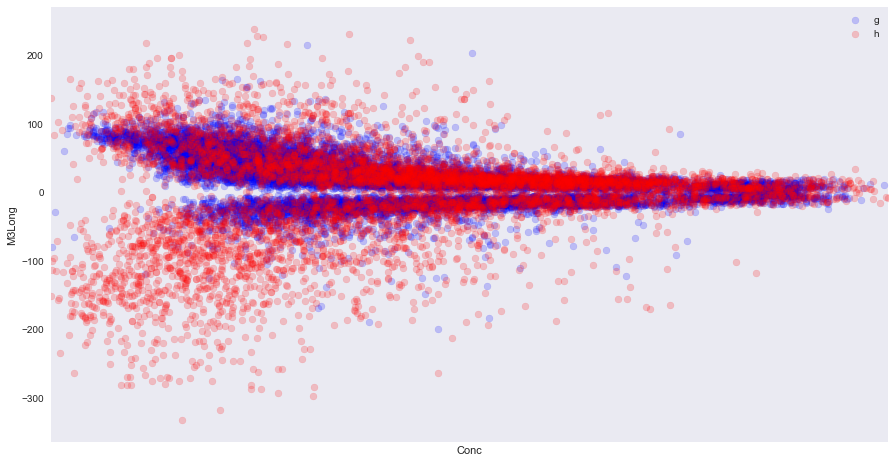

Conc M3Trans


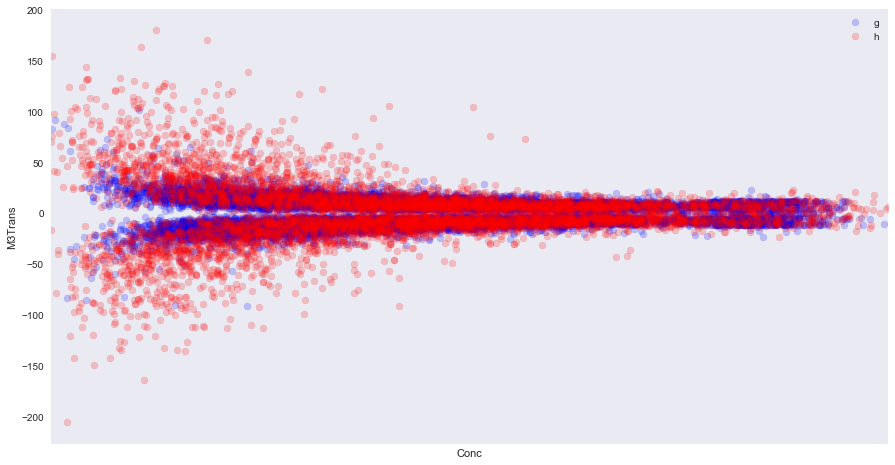

Conc Alpha


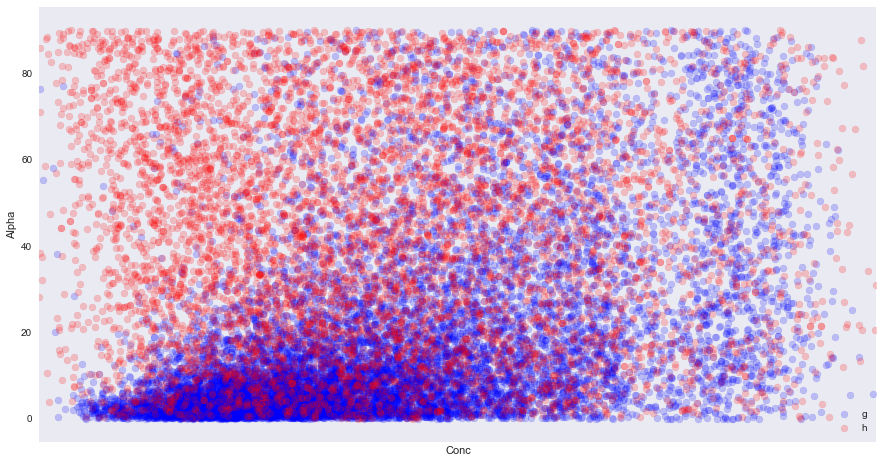

Conc Dist


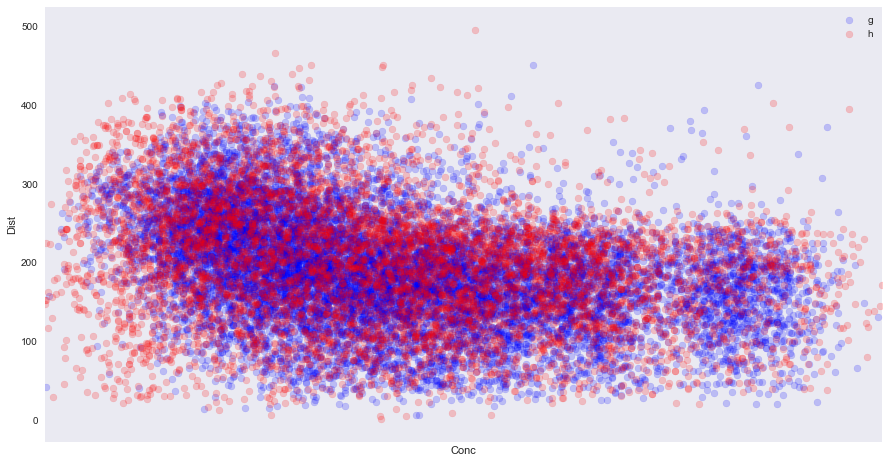

Conc1 Asym


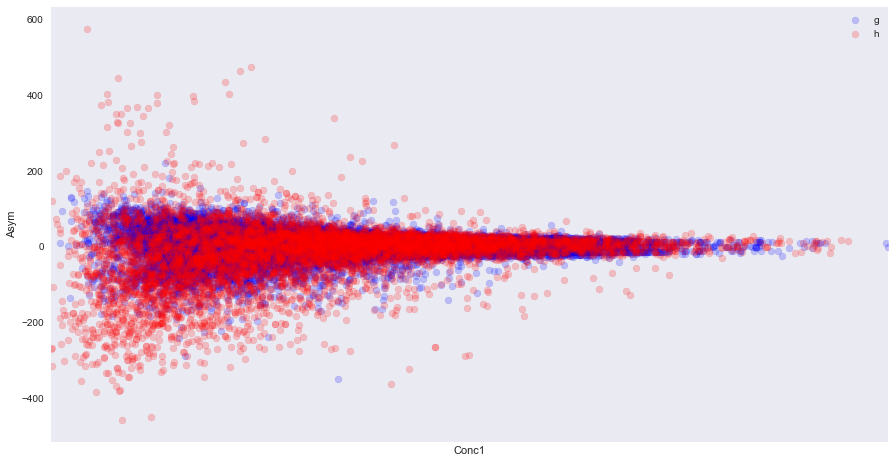

Conc1 M3Long


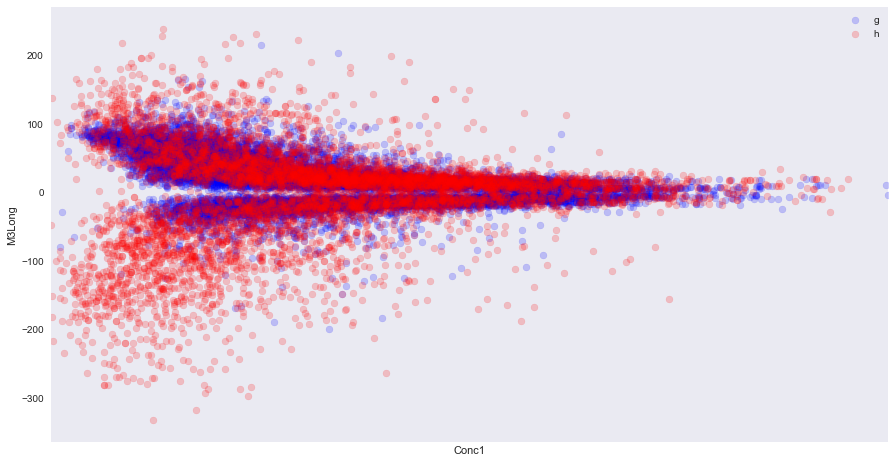

Conc1 M3Trans


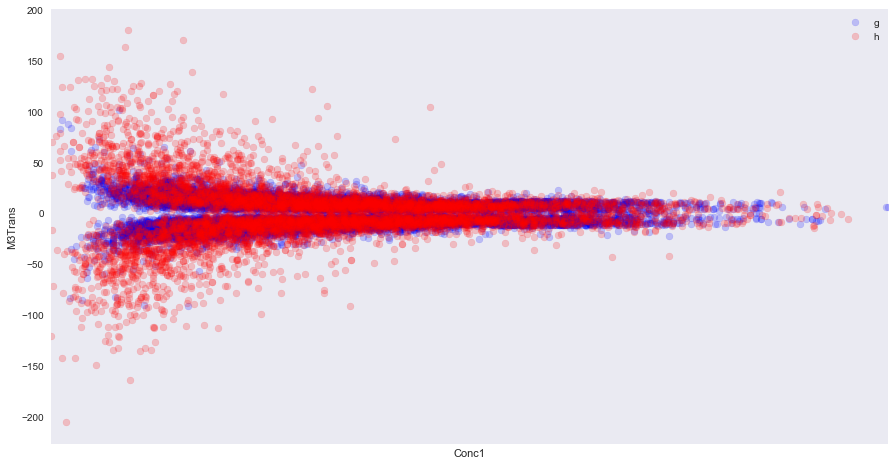

Conc1 Alpha


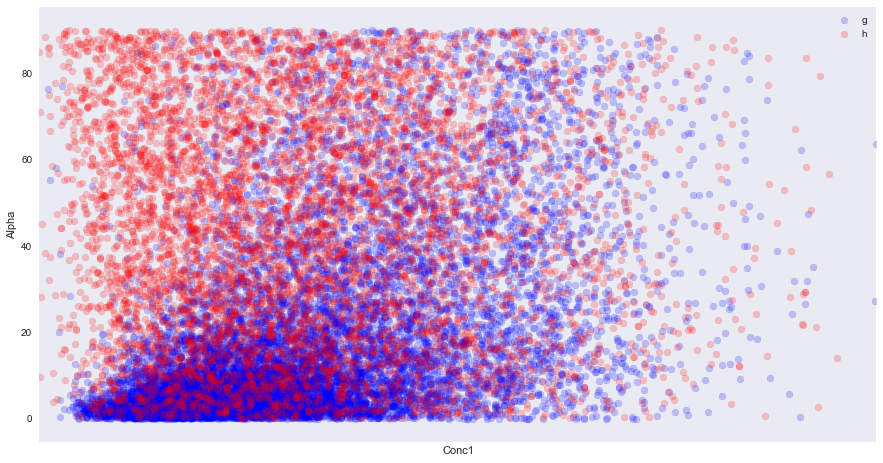

Conc1 Dist


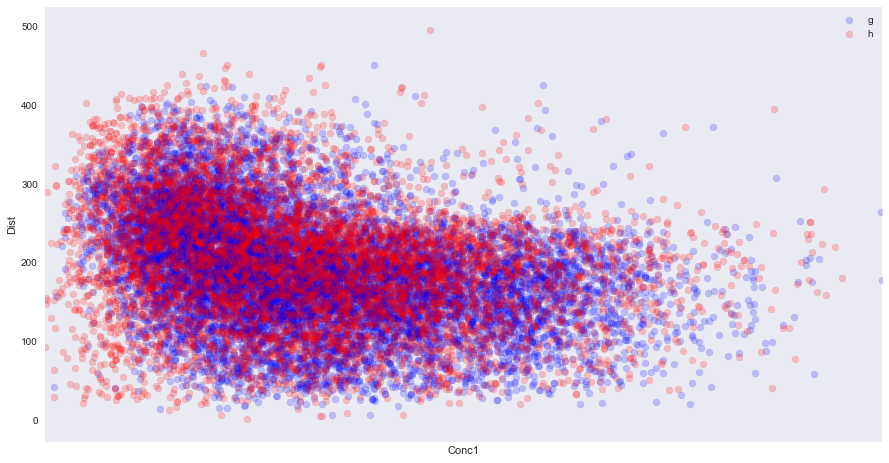

Asym M3Long


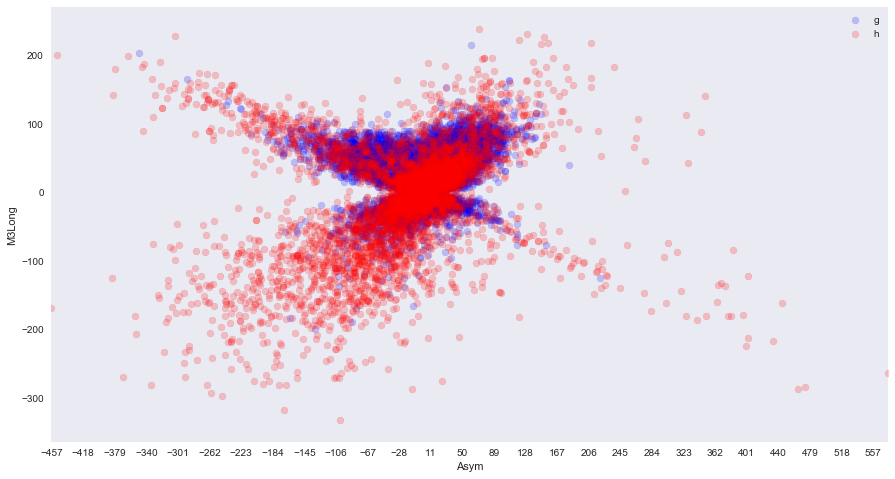

Asym M3Trans


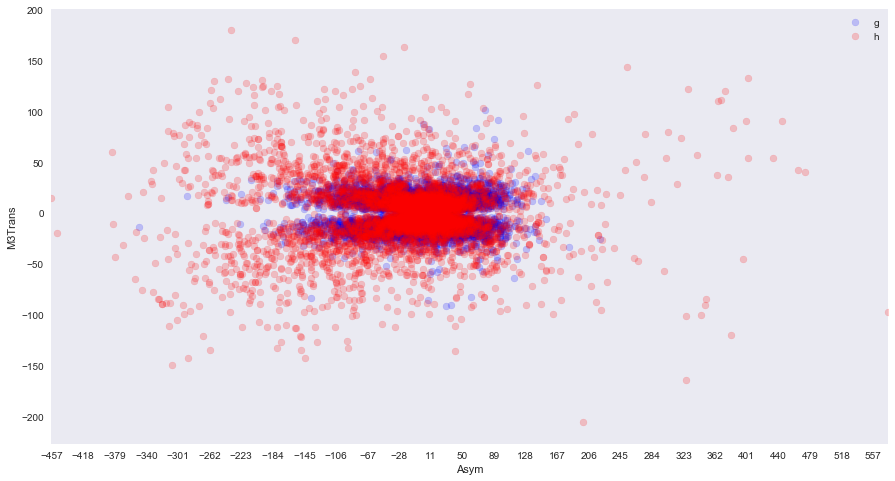

Asym Alpha


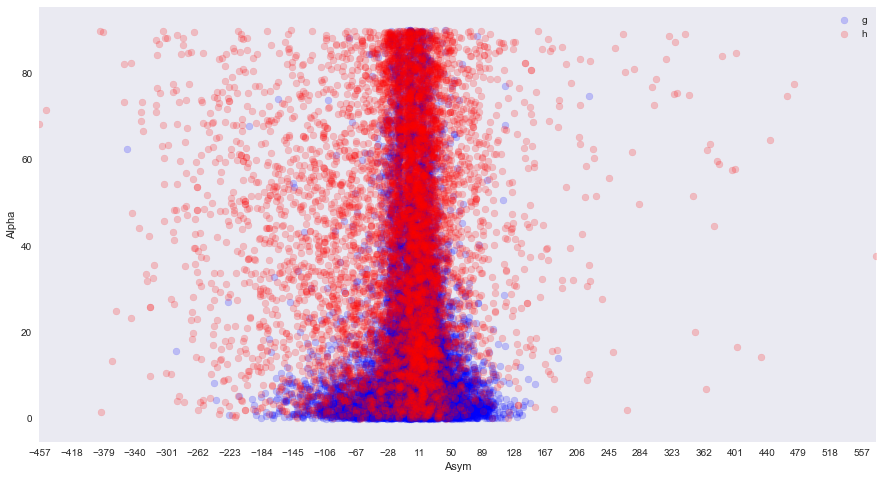

Asym Dist


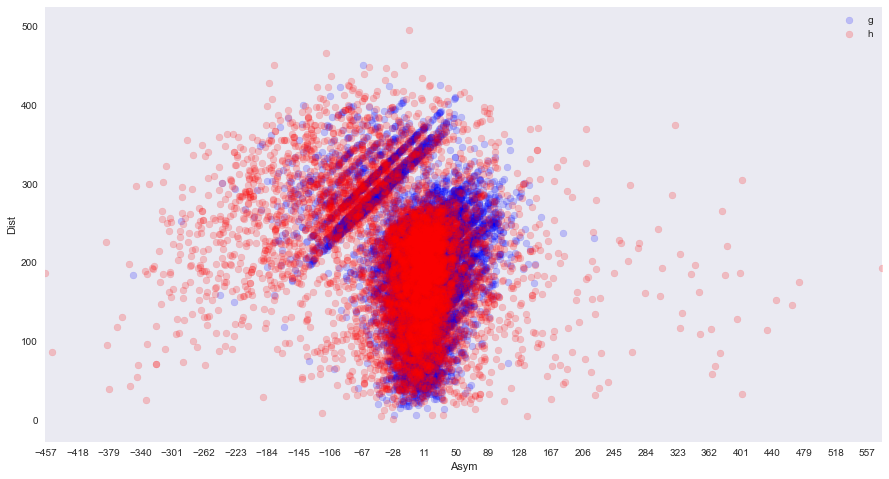

M3Long M3Trans


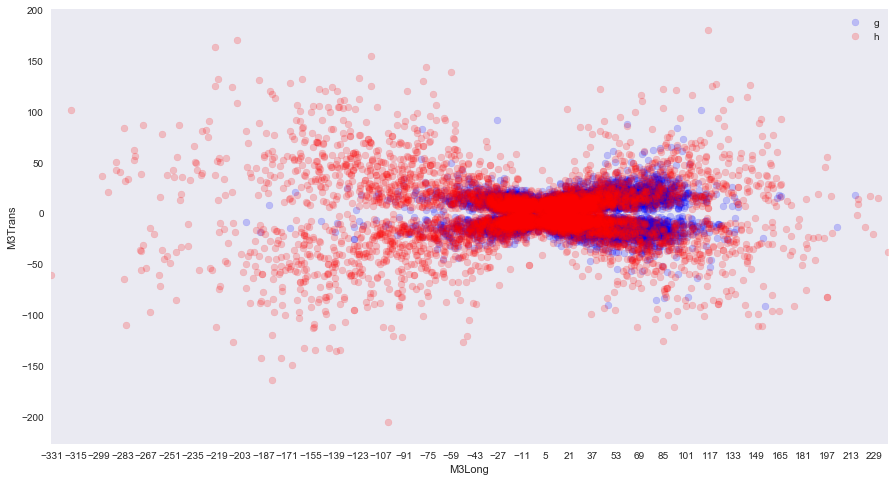

M3Long Alpha


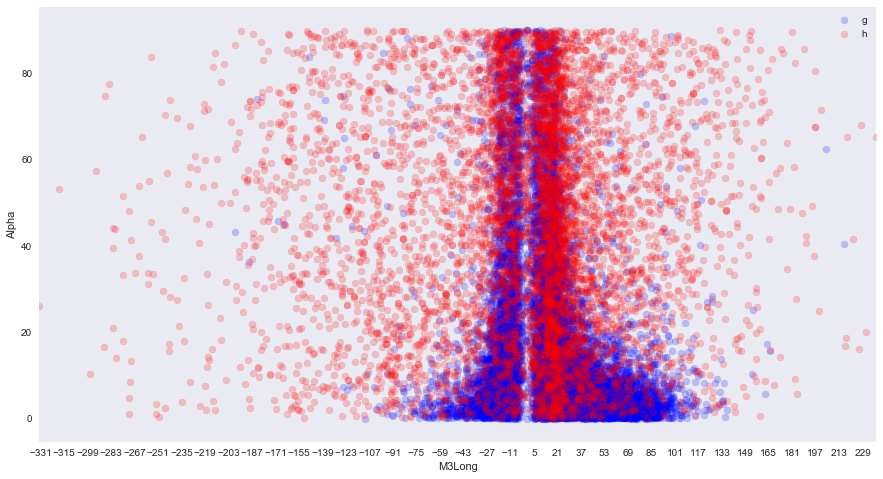

M3Long Dist


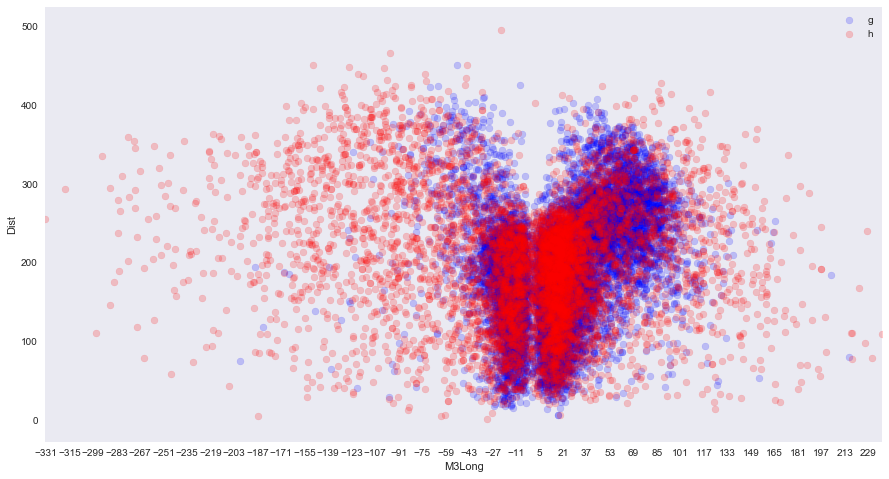

M3Trans Alpha


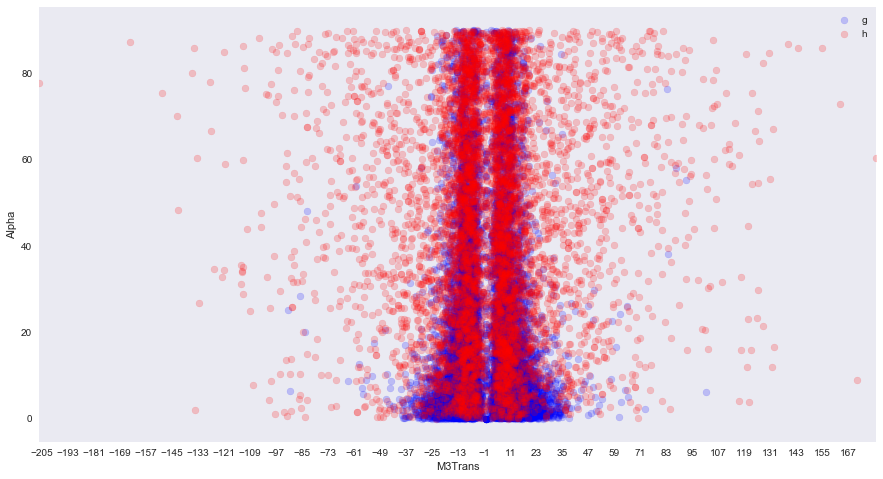

M3Trans Dist


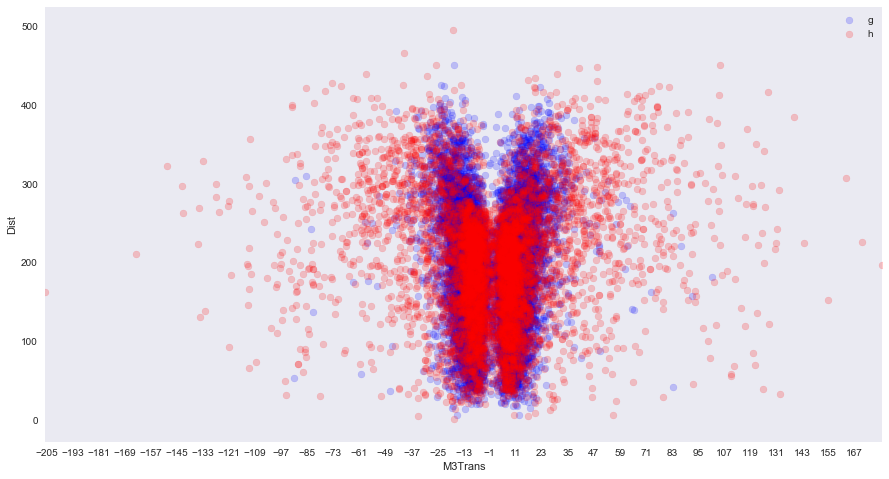

Alpha Dist


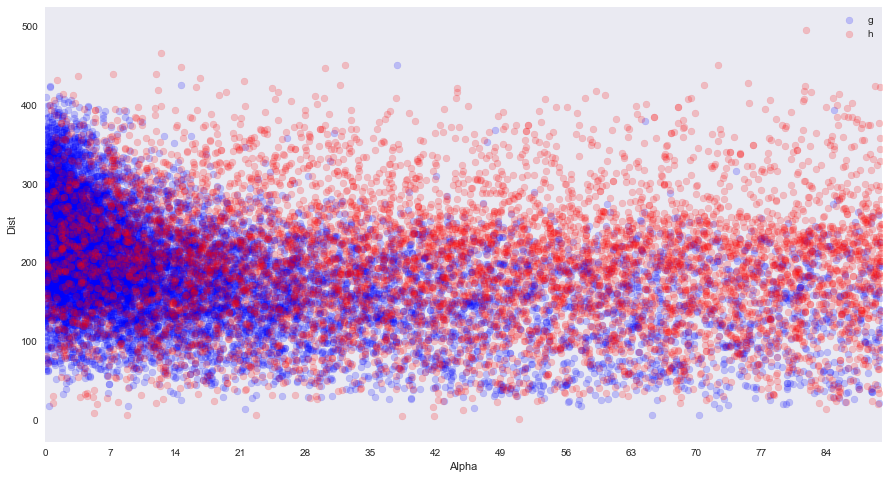

In [11]:
for i in range(0,len(data.columns)):
    for j in range(i+1,len(data.columns) -1 ):
        print(data.columns[i],data.columns[j])
        plt.scatter(data[data['class'] == 'g'][data.columns[i]],
            data[data['class'] == 'g'][data.columns[j]],
            alpha = 0.2,
            label = 'g',
            color = 'b')

        plt.scatter(data[data['class'] == 'h'][data.columns[i]],
                    data[data['class'] == 'h'][data.columns[j]],
                    alpha = 0.2,
                    label = 'h',
                    color = 'r')

        max_value = data[data.columns[i]].max()
        min_value = data[data.columns[i]].min()
        plt.xlabel(data.columns[i])
        plt.xticks(range(int(min_value),int(max_value),int(max_value/15) + 1))
        plt.xlim(min_value, max_value)
        plt.ylabel(data.columns[j])
        plt.legend()
        plt.grid()
        plt.show()

### Посмотрим на Box Plots

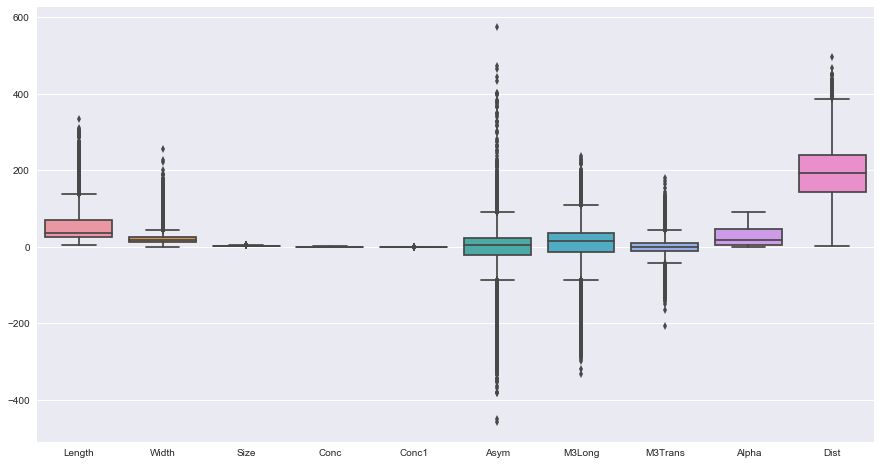

In [12]:
sns.boxplot(data)

In [13]:
iplot([go.Box(y=data[genre], name=genre) for genre in data.columns], show_link = False)
# интерактивный график, который позволяет смотреть точные значения при наведении мыши
# В GITHUB НЕ ОТОБРАЖАЕТСЯ

# Задача

- Все признаки количественные
- Пропусков в данных нет  

**Для начала не будем делать препроцессинг, чтобы посмотреть на результаты без предобработки, а затем сравним с результатами на предобработанных данных. **

### Разделим данные на обучающую и тестовую выборку

In [14]:
X = data.iloc[:,:-1]
y = data.iloc[:,-1]

In [15]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33,random_state=7)

### KNN
`k_neighbors = [1,2,3,4,5,10,15,30,50,100,150,250,500]`

In [16]:
scores = []
err_train = []
err_test = []
k_neighbors = [1,2,3,4,5,10,15,30,50,100,150,250,500]
for k in k_neighbors:
    start_time = datetime.datetime.now()
    
    model = KNeighborsClassifier(n_jobs=-1,n_neighbors=k)
    model.fit(X_train,y_train)
    
    y_pred = model.predict(X_test)
    scores.append(accuracy_score(y_pred,y_test))
    
    err_test.append(np.mean(y_pred != y_test))
    err_train.append(np.mean(model.predict(X_train) != y_train))
    
    print('k = ' + str(k))
    print('Time elapsed: ' + str(datetime.datetime.now() - start_time))
    print('Train error: ' + str(err_train[-1]))
    print('Test error: ' + str(err_test[-1]))
    print('Accuracy score: ' + str(scores[-1]))
    print()

k = 1
Time elapsed: 0:00:00.385132
Train error: 0.0
Test error: 0.21459295842
Accuracy score: 0.78540704158

k = 2
Time elapsed: 0:00:00.465112
Train error: 0.13018912344
Test error: 0.214433646646
Accuracy score: 0.785566353354

k = 3
Time elapsed: 0:00:00.562611
Train error: 0.115671348976
Test error: 0.198821092879
Accuracy score: 0.801178907121

k = 4
Time elapsed: 0:00:00.570449
Train error: 0.155850270737
Test error: 0.197068663374
Accuracy score: 0.802931336626

k = 5
Time elapsed: 0:00:00.677245
Train error: 0.146590284862
Test error: 0.187350645213
Accuracy score: 0.812649354787

k = 10
Time elapsed: 0:00:00.576867
Train error: 0.173977870203
Test error: 0.18926238649
Accuracy score: 0.81073761351

k = 15
Time elapsed: 0:00:00.693151
Train error: 0.17680295064
Test error: 0.185438903935
Accuracy score: 0.814561096065

k = 30
Time elapsed: 0:00:00.908127
Train error: 0.190222082712
Test error: 0.193563804365
Accuracy score: 0.806436195635

k = 50
Time elapsed: 0:00:01.027504
Tr

### График доли правильных ответов на тестовой выборке от числа ближайших соседей

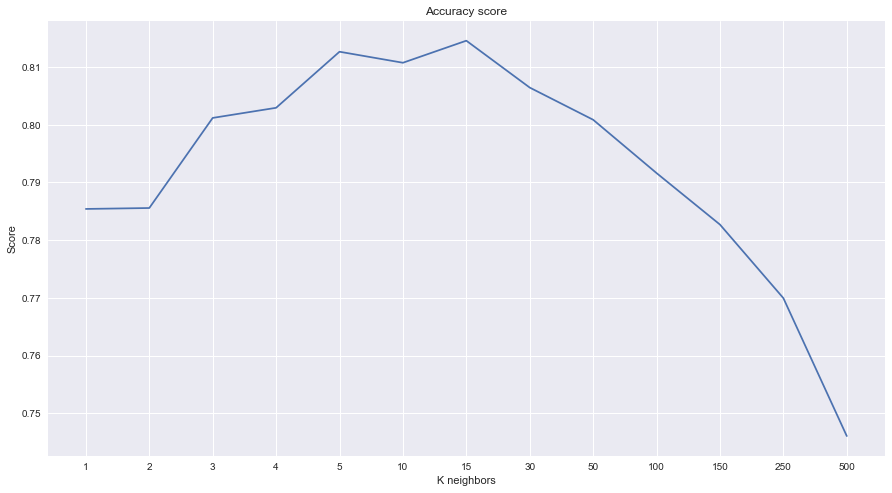

In [17]:
plt.plot(scores)
plt.xticks(range(13),k_neighbors)
plt.xlabel('K neighbors')
plt.ylabel('Score')
plt.title('Accuracy score')

### График ошибок на тренировочной выборке от числа ближайших соседей

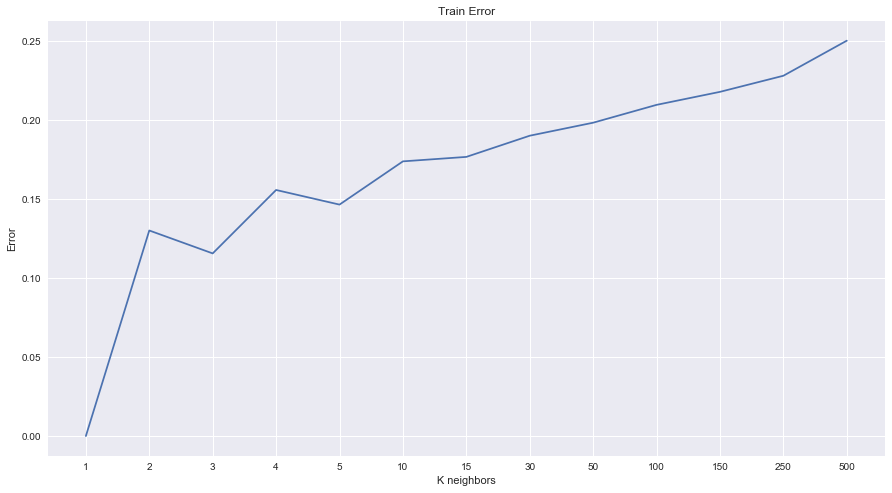

In [18]:
plt.plot(err_train)
plt.xticks(range(13),k_neighbors)
plt.xlabel('K neighbors')
plt.ylabel('Error')
plt.title('Train Error')

### График ошибок на тестовой выборке от числа ближайших соседей

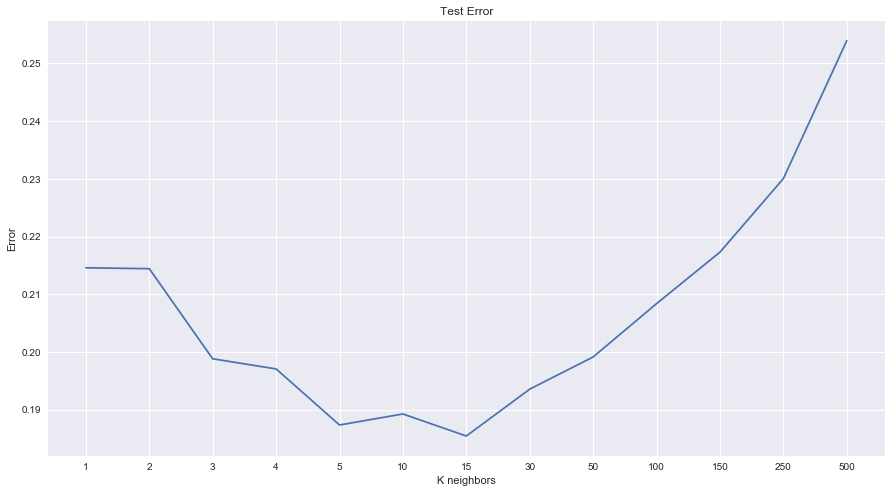

In [19]:
plt.plot(err_test)
plt.xticks(range(13),k_neighbors)
plt.xlabel('K neighbors')
plt.ylabel('Error')
plt.title('Test Error')

### Общий график

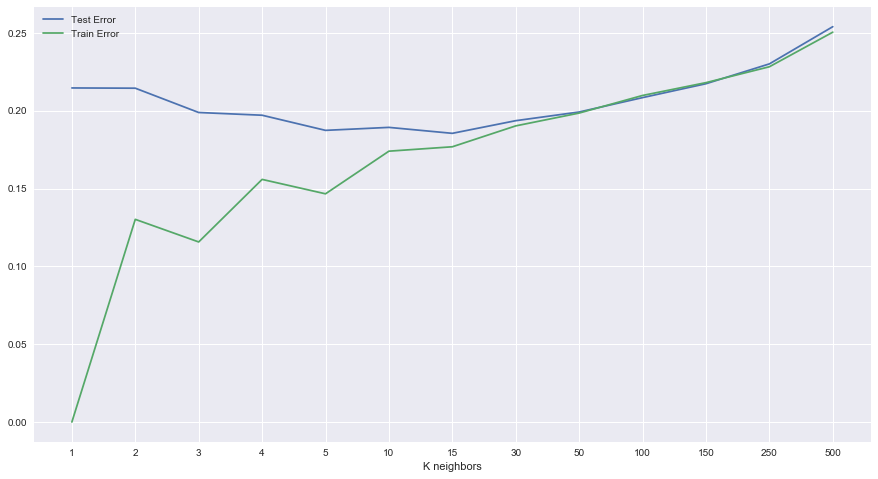

In [20]:
plt.plot(err_test, label = 'Test Error')
plt.plot(err_train, label = 'Train Error')
plt.xticks(range(13),k_neighbors)
plt.xlabel('K neighbors')
plt.legend()

### Стандартизация данных

In [21]:
X = scale(data.iloc[:,:-1])
y = data.iloc[:,-1]

In [22]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33,random_state=7)

### КNN + scale

In [23]:
scores = []
err_train = []
err_test = []
k_neighbors = [1,2,3,4,5,10,15,30,50,100,150,250,500]
for k in k_neighbors:
    start_time = datetime.datetime.now()
    
    model = KNeighborsClassifier(n_jobs=-1,n_neighbors=k)
    model.fit(X_train,y_train)
    
    y_pred = model.predict(X_test)
    scores.append(accuracy_score(y_pred,y_test))
    
    err_test.append(np.mean(y_pred != y_test))
    err_train.append(np.mean(model.predict(X_train) != y_train))
    
    print('k = ' + str(k))
    print('Time elapsed: ' + str(datetime.datetime.now() - start_time))
    print('Train error: ' + str(err_train[-1]))
    print('Test error: ' + str(err_test[-1]))
    print('Accuracy score: ' + str(scores[-1]))
    print()

k = 1
Time elapsed: 0:00:00.366798
Train error: 0.0
Test error: 0.178747809463
Accuracy score: 0.821252190537

k = 2
Time elapsed: 0:00:00.669201
Train error: 0.117711684847
Test error: 0.180659550741
Accuracy score: 0.819340449259

k = 3
Time elapsed: 0:00:00.879278
Train error: 0.0986423919014
Test error: 0.160426955552
Accuracy score: 0.839573044448

k = 4
Time elapsed: 0:00:00.891650
Train error: 0.134348269638
Test error: 0.166480802931
Accuracy score: 0.833519197069

k = 5
Time elapsed: 0:00:00.981101
Train error: 0.124382013655
Test error: 0.155806914131
Accuracy score: 0.844193085869

k = 10
Time elapsed: 0:00:01.190392
Train error: 0.150592482147
Test error: 0.159949020233
Accuracy score: 0.840050979767

k = 15
Time elapsed: 0:00:01.386781
Train error: 0.149964686495
Test error: 0.15676278477
Accuracy score: 0.84323721523

k = 30
Time elapsed: 0:00:01.711924
Train error: 0.162128227262
Test error: 0.164569061654
Accuracy score: 0.835430938346

k = 50
Time elapsed: 0:00:02.0714

### График доли правильных ответов на тестовой выборке от числа ближайших соседей

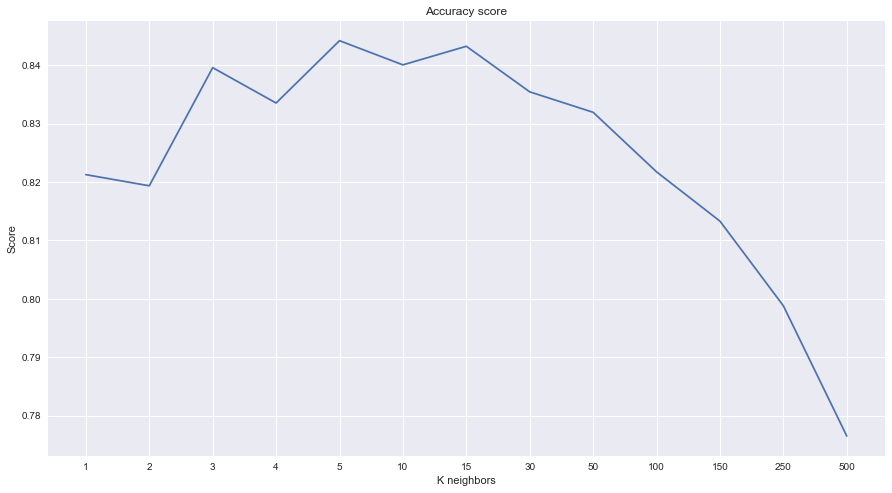

In [24]:
plt.plot(scores)
plt.xticks(range(13),k_neighbors)
plt.xlabel('K neighbors')
plt.ylabel('Score')
plt.title('Accuracy score')

### График ошибок на тренировочной выборке от числа ближайших соседей

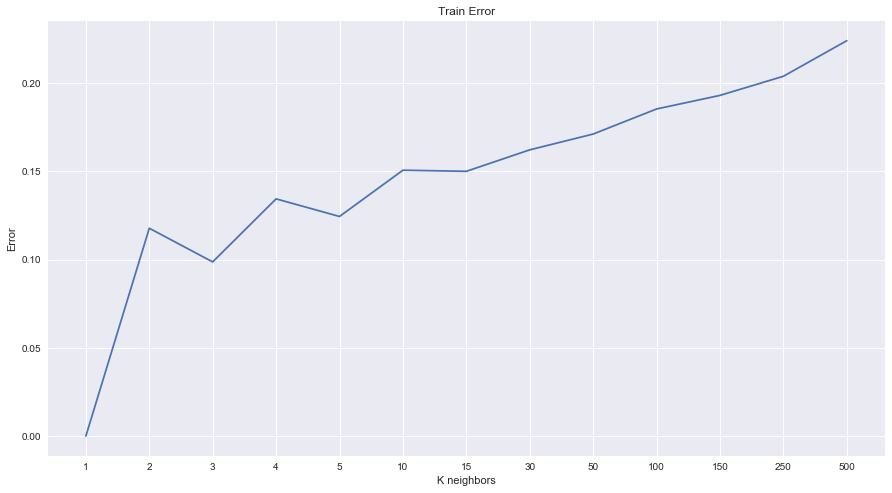

In [25]:
plt.plot(err_train)
plt.xticks(range(13),k_neighbors)
plt.xlabel('K neighbors')
plt.ylabel('Error')
plt.title('Train Error')

### График ошибок на тестовой выборке от числа ближайших соседей

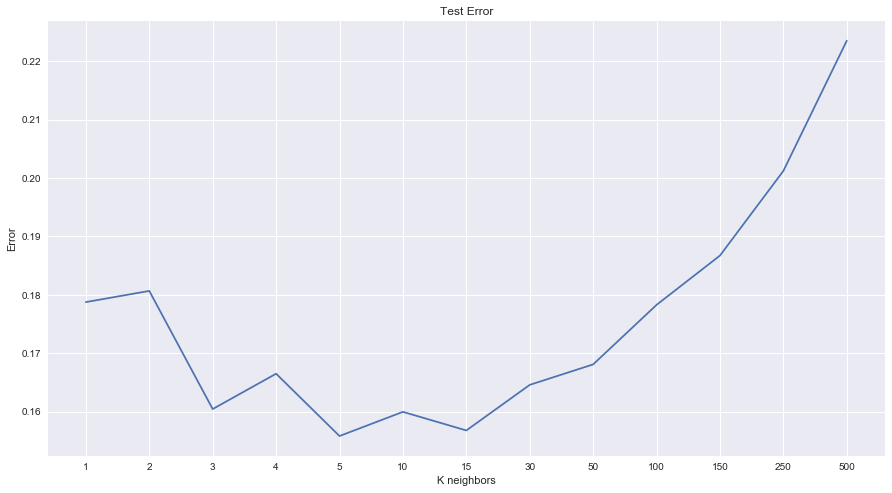

In [26]:
plt.plot(err_test)
plt.xticks(range(13),k_neighbors)
plt.xlabel('K neighbors')
plt.ylabel('Error')
plt.title('Test Error')

### Общий график

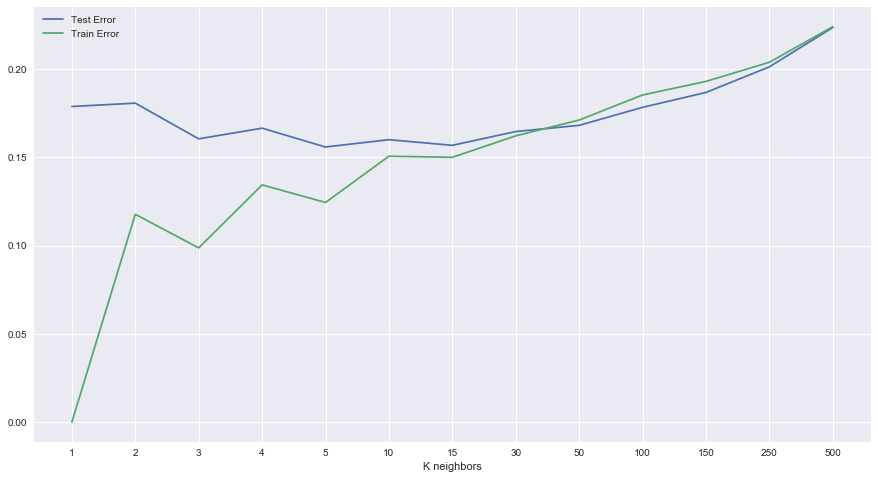

In [27]:
plt.plot(err_test, label = 'Test Error')
plt.plot(err_train, label = 'Train Error')
plt.xticks(range(13),k_neighbors)
plt.xlabel('K neighbors')
plt.legend()

## Выводы
### Лучшие результаты
- **KNN** без предобработки при **k=15** *Accuracy* - **0.814561096065**
- **KNN** со стандартизацией при **k=5** *Accuracy* - **0.844193085869**

Стандартизация позволила улучшить *Accuracy* на **0.029631989804**.  
В дальнейшем, для улучшения качества, необходимо произвести *feature engineering*, так как в выборке много коррелируемых признаков и выбросов, что видно на **box plot**, ну и, естественно, попробовать другие методы машинного обучения.